In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from datetime import datetime
from datetime import datetime
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

In [2]:
df=pd.read_csv(r'E:\DiseasesDiagnosis\notebook\data\final_data.csv')

In [3]:
df.head()

,Patient_ID,Gender,Date_of_Birth,Blood Pressure (systolic),Blood Pressure (diastolic),Heart Rate,Respiratory Rate,Temperature (Celsius),Oxygen Saturation,Glucose Level,Cholesterol Level,Diagnosis Code,Diagnosis
0,1,Male,2006-05-05,144,72,106,26,37.3,86%,90,237,51881,Acute Respiratory Failure
1,2,Female,1949-08-02,95,65,102,26,37.4,93%,141,176,4019,Hypertension
2,3,Male,1996-08-18,173,112,60,20,36.8,94%,139,226,4100,Coronary Artery Disease
3,4,Male,1982-06-10,139,69,54,19,37.0,98%,150,180,4100,Coronary Artery Disease
4,5,Male,1956-01-14,173,85,83,19,36.7,97%,109,291,41401,Chronic Ischemic Heart Disease


In [4]:
df.tail()

,Patient_ID,Gender,Date_of_Birth,Blood Pressure (systolic),Blood Pressure (diastolic),Heart Rate,Respiratory Rate,Temperature (Celsius),Oxygen Saturation,Glucose Level,Cholesterol Level,Diagnosis Code,Diagnosis
999995,999996,Female,1966-08-25,90,98,93,20,37.6,90%,175,295,7802,Syncope and Collapse
999996,999997,Female,1993-03-14,163,71,103,13,37.1,88%,166,206,5859,Chronic Kidney Disease
999997,999998,Female,2005-07-14,173,83,115,25,36.8,96%,180,260,41401,Chronic Ischemic Heart Disease
999998,999999,Female,1937-01-17,156,86,69,12,36.0,85%,95,296,4280,Heart Failure
999999,1000000,Male,2009-02-19,173,112,62,18,35.9,93%,173,231,51881,Acute Respiratory Failure


## **➡️ Checking Null values: & remove the Duplicate values:**

In [5]:
df.isnull().sum()

Patient_ID                    0
Gender                        0
Date_of_Birth                 0
Blood Pressure (systolic)     0
Blood Pressure (diastolic)    0
Heart Rate                    0
Respiratory Rate              0
Temperature (Celsius)         0
Oxygen Saturation             0
Glucose Level                 0
Cholesterol Level             0
Diagnosis Code                0
Diagnosis                     0
dtype: int64

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000000 entries, 0 to 999999
Data columns (total 13 columns):
 #   Column                      Non-Null Count    Dtype  
---  ------                      --------------    -----  
 0   Patient_ID                  1000000 non-null  int64  
 1   Gender                      1000000 non-null  object 
 2   Date_of_Birth               1000000 non-null  object 
 3   Blood Pressure (systolic)   1000000 non-null  int64  
 4   Blood Pressure (diastolic)  1000000 non-null  int64  
 5   Heart Rate                  1000000 non-null  int64  
 6   Respiratory Rate            1000000 non-null  int64  
 7   Temperature (Celsius)       1000000 non-null  float64
 8   Oxygen Saturation           1000000 non-null  object 
 9   Glucose Level               1000000 non-null  int64  
 10  Cholesterol Level           1000000 non-null  int64  
 11  Diagnosis Code              1000000 non-null  int64  
 12  Diagnosis                   1000000 non-null  object 
dty

<Axes: >

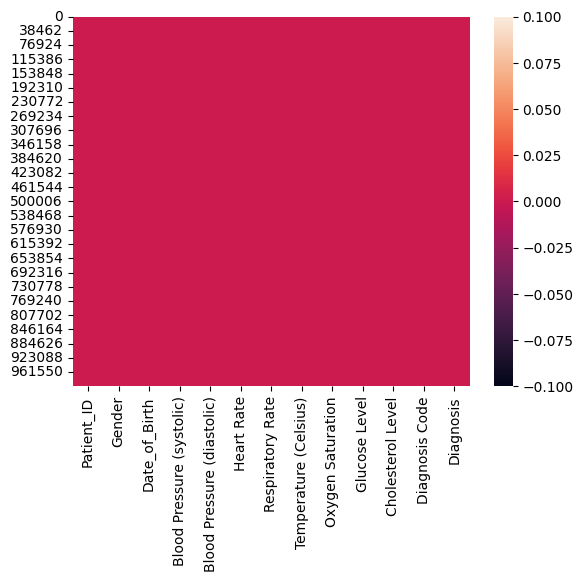

In [7]:
sns.heatmap(df.isnull())

In [8]:
df.shape

(1000000, 13)

In [10]:
df.drop_duplicates(inplace=True)

In [11]:
df.shape

(1000000, 13)

- Calculate the 'Age' Column by using `Date_of_Birth` and `current date` value

In [60]:
## Current date
current_date = datetime(2025, 4, 10)

## Calculate age
df['Age'] = df['Date_of_Birth'].apply(lambda dob: current_date.year - pd.to_datetime(dob).year - 
                                    ((current_date.month, current_date.day) < (pd.to_datetime(dob).month, pd.to_datetime(dob).day)))


- remove `%` from `Oxygen Saturation` columns.

In [61]:
df['Oxygen Saturation %'] = df['Oxygen Saturation'].str.replace('%', '').astype(int)

In [62]:
df.head()

,Patient_ID,Gender,Date_of_Birth,Blood Pressure (systolic),Blood Pressure (diastolic),Heart Rate,Respiratory Rate,Temperature (Celsius),Oxygen Saturation,Glucose Level,Cholesterol Level,Diagnosis Code,Diagnosis,Age,Oxygen Saturation %
0,1,Male,2006-05-05,144,72,106,26,37.3,86%,90,237,51881,Acute Respiratory Failure,18,86
1,2,Female,1949-08-02,95,65,102,26,37.4,93%,141,176,4019,Hypertension,75,93
2,3,Male,1996-08-18,173,112,60,20,36.8,94%,139,226,4100,Coronary Artery Disease,28,94
3,4,Male,1982-06-10,139,69,54,19,37.0,98%,150,180,4100,Coronary Artery Disease,42,98
4,5,Male,1956-01-14,173,85,83,19,36.7,97%,109,291,41401,Chronic Ischemic Heart Disease,69,97


In [63]:
df.drop(['Oxygen Saturation','Date_of_Birth'],axis=1,inplace=True)

In [65]:
df['Diagnosis'].unique()

array(['Acute Respiratory Failure', 'Hypertension',
       'Coronary Artery Disease', 'Chronic Ischemic Heart Disease',
       'Chronic Kidney Disease', 'Stroke', 'Heart Failure',
       'Diabetes Mellitus', 'Asthma', 'Syncope and Collapse'],
      dtype=object)

In [66]:
df['Diagnosis'].value_counts()

Diagnosis
Acute Respiratory Failure         100489
Chronic Ischemic Heart Disease    100392
Asthma                            100301
Stroke                            100021
Heart Failure                      99917
Hypertension                       99887
Coronary Artery Disease            99869
Diabetes Mellitus                  99746
Syncope and Collapse               99724
Chronic Kidney Disease             99654
Name: count, dtype: int64

In [67]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000000 entries, 0 to 999999
Data columns (total 13 columns):
 #   Column                      Non-Null Count    Dtype  
---  ------                      --------------    -----  
 0   Patient_ID                  1000000 non-null  int64  
 1   Gender                      1000000 non-null  object 
 2   Blood Pressure (systolic)   1000000 non-null  int64  
 3   Blood Pressure (diastolic)  1000000 non-null  int64  
 4   Heart Rate                  1000000 non-null  int64  
 5   Respiratory Rate            1000000 non-null  int64  
 6   Temperature (Celsius)       1000000 non-null  float64
 7   Glucose Level               1000000 non-null  int64  
 8   Cholesterol Level           1000000 non-null  int64  
 9   Diagnosis Code              1000000 non-null  int64  
 10  Diagnosis                   1000000 non-null  object 
 11  Age                         1000000 non-null  int64  
 12  Oxygen Saturation %         1000000 non-null  int32  
dty

---

### 🔍 **1. Descriptive Analysis**
- **Summarize vital signs** (e.g., mean/median heart rate, blood pressure, glucose, etc.).
- **Distribution by diagnosis** (e.g., how many patients have each diagnosis).

---

In [68]:
df.describe()

,Patient_ID,Blood Pressure (systolic),Blood Pressure (diastolic),Heart Rate,Respiratory Rate,Temperature (Celsius),Glucose Level,Cholesterol Level,Diagnosis Code,Age,Oxygen Saturation %
count,1000000.000000,1000000.000000,1000000.000000,1000000.000000,1000000.000000,1000000.000000,1000000.000000,1000000.000000,1000000.000000,1000000.000000,1000000.000000
mean,500000.500000,134.501649,89.531254,84.488223,20.510179,37.000372,134.517606,224.438081,13148.214538,54.773454,92.004354
std,288675.278932,25.985973,17.314728,20.209655,5.186172,0.500753,37.553245,43.286929,17007.086517,28.849000,4.322043
min,1.000000,90.000000,60.000000,50.000000,12.000000,34.700000,70.000000,150.000000,2500.000000,5.000000,85.000000
25%,250000.750000,112.000000,75.000000,67.000000,16.000000,36.700000,102.000000,187.000000,4100.000000,30.000000,88.000000
50%,500000.500000,134.000000,90.000000,85.000000,21.000000,37.000000,135.000000,224.000000,4939.000000,55.000000,92.000000
75%,750000.250000,157.000000,105.000000,102.000000,25.000000,37.300000,167.000000,262.000000,7802.000000,80.000000,96.000000
max,1000000.000000,179.000000,119.000000,119.000000,29.000000,39.800000,199.000000,299.000000,51881.000000,105.000000,99.000000


In [70]:
## List of columns
columns = [
    'Blood Pressure (systolic)',
    'Blood Pressure (diastolic)',
    'Heart Rate',
    'Respiratory Rate',
    'Temperature (Celsius)',
    'Glucose Level',
    'Cholesterol Level',
    'Age',
    'Oxygen Saturation %'
]

## Create subplots: 3 rows, 3 columns
fig = make_subplots(rows=3, cols=3, subplot_titles=columns)

## Add histograms to the subplots
row = col = 1
for i, col_name in enumerate(columns):
    fig.add_trace(
        go.Histogram(x=df[col_name], name=col_name),
        row=row,
        col=col
    )
    col += 1
    if col > 3:
        col = 1
        row += 1

## Update layout
fig.update_layout(
    title_text="Distribution Plots of Vital Signs and Lab Values",
    height=900,
    showlegend=False
)

fig.show()



### 📊 **2. Diagnostic Pattern Analysis**
- **Correlate symptoms with diagnoses**, such as:
  - Low oxygen saturation with **Acute Respiratory Failure**.
  - High systolic/diastolic blood pressure with **Hypertension**.
  - High cholesterol and glucose with **Coronary Artery Disease** or **Chronic Ischemic Heart Disease**.
  
---

In [71]:
df[df['Diagnosis']=='Acute Respiratory Failure']

,Patient_ID,Gender,Blood Pressure (systolic),Blood Pressure (diastolic),Heart Rate,Respiratory Rate,Temperature (Celsius),Glucose Level,Cholesterol Level,Diagnosis Code,Diagnosis,Age,Oxygen Saturation %
0,1,Male,144,72,106,26,37.3,90,237,51881,Acute Respiratory Failure,18,86
5,6,Female,117,104,88,24,36.4,149,176,51881,Acute Respiratory Failure,76,86
14,15,Female,145,76,81,27,37.2,188,217,51881,Acute Respiratory Failure,67,97
21,22,Male,114,104,87,13,37.8,83,211,51881,Acute Respiratory Failure,49,94
29,30,Female,159,110,104,28,36.8,97,298,51881,Acute Respiratory Failure,49,98
...,...,...,...,...,...,...,...,...,...,...,...,...,...
999966,999967,Female,115,106,84,28,36.8,117,193,51881,Acute Respiratory Failure,31,97
999970,999971,Female,104,62,62,14,38.1,75,278,51881,Acute Respiratory Failure,57,85
999976,999977,Male,106,69,119,27,37.5,188,279,51881,Acute Respiratory Failure,55,85
999991,999992,Female,177,70,51,22,36.3,172,185,51881,Acute Respiratory Failure,39,93


In [72]:
df.head()

,Patient_ID,Gender,Blood Pressure (systolic),Blood Pressure (diastolic),Heart Rate,Respiratory Rate,Temperature (Celsius),Glucose Level,Cholesterol Level,Diagnosis Code,Diagnosis,Age,Oxygen Saturation %
0,1,Male,144,72,106,26,37.3,90,237,51881,Acute Respiratory Failure,18,86
1,2,Female,95,65,102,26,37.4,141,176,4019,Hypertension,75,93
2,3,Male,173,112,60,20,36.8,139,226,4100,Coronary Artery Disease,28,94
3,4,Male,139,69,54,19,37.0,150,180,4100,Coronary Artery Disease,42,98
4,5,Male,173,85,83,19,36.7,109,291,41401,Chronic Ischemic Heart Disease,69,97


In [73]:
def diagnostic_patterns(row):
    alerts = []
    
    # Low Oxygen Saturation
    if row['Oxygen Saturation %'] < 90:
        alerts.append("Low Oxygen Saturation")
    
    # High Blood Pressure
    if row['Blood Pressure (systolic)'] > 140 or row['Blood Pressure (diastolic)'] > 90:
        alerts.append("High Blood Pressure")
    
    # High Glucose and Cholesterol
    if row['Glucose Level'] > 126 and row['Cholesterol Level'] > 200:
        alerts.append("High Glucose & Cholesterol")
    
    return ", ".join(alerts) if alerts else "Normal"

# Apply the pattern detection
df['Diagnostic_Patterns'] = df.apply(diagnostic_patterns, axis=1)

# Display the summary
df[['Patient_ID', 'Diagnosis', 'Diagnostic_Patterns']]


,Patient_ID,Diagnosis,Diagnostic_Patterns
0,1,Acute Respiratory Failure,"Low Oxygen Saturation, High Blood Pressure"
1,2,Hypertension,Normal
2,3,Coronary Artery Disease,"High Blood Pressure, High Glucose & Cholesterol"
3,4,Coronary Artery Disease,Normal
4,5,Chronic Ischemic Heart Disease,High Blood Pressure
...,...,...,...
999995,999996,Syncope and Collapse,"High Blood Pressure, High Glucose & Cholesterol"
999996,999997,Chronic Kidney Disease,"Low Oxygen Saturation, High Blood Pressure, Hi..."
999997,999998,Chronic Ischemic Heart Disease,"High Blood Pressure, High Glucose & Cholesterol"
999998,999999,Heart Failure,"Low Oxygen Saturation, High Blood Pressure"


In [74]:
## Check the 
Diagnosis=df['Diagnosis'].unique()
for i in Diagnosis:
    # print(50*'____')
    print(f'Diagnostic_Patterns for:--> {i} ')
    print(df[df['Diagnosis']==i]['Diagnostic_Patterns'].unique())
    print(40*'_ _ _')

Diagnostic_Patterns for:--> Acute Respiratory Failure 
['Low Oxygen Saturation, High Blood Pressure'
 'High Blood Pressure, High Glucose & Cholesterol' 'High Blood Pressure'
 'Low Oxygen Saturation'
 'Low Oxygen Saturation, High Glucose & Cholesterol'
 'High Glucose & Cholesterol' 'Normal'
 'Low Oxygen Saturation, High Blood Pressure, High Glucose & Cholesterol']
_ _ __ _ __ _ __ _ __ _ __ _ __ _ __ _ __ _ __ _ __ _ __ _ __ _ __ _ __ _ __ _ __ _ __ _ __ _ __ _ __ _ __ _ __ _ __ _ __ _ __ _ __ _ __ _ __ _ __ _ __ _ __ _ __ _ __ _ __ _ __ _ __ _ __ _ __ _ __ _ _
Diagnostic_Patterns for:--> Hypertension 
['Normal' 'Low Oxygen Saturation, High Blood Pressure'
 'Low Oxygen Saturation, High Blood Pressure, High Glucose & Cholesterol'
 'High Blood Pressure' 'Low Oxygen Saturation'
 'High Glucose & Cholesterol'
 'High Blood Pressure, High Glucose & Cholesterol'
 'Low Oxygen Saturation, High Glucose & Cholesterol']
_ _ __ _ __ _ __ _ __ _ __ _ __ _ __ _ __ _ __ _ __ _ __ _ __ _ __ _ __ _ __ _ _

In [ ]:


## Creating the data manually from the image
data = {
    "Patient_ID": [1, 2, 3, 4, 5],
    "Diagnosis": [        
        'Acute Respiratory Failure', 'Hypertension',
        'Coronary Artery Disease', 'Chronic Ischemic Heart Disease',
        'Chronic Kidney Disease', 'Stroke', 'Heart Failure',
        'Diabetes Mellitus', 'Asthma', 'Syncope and Collapse'
    ]
}

df1 = pd.DataFrame(data)

In [ ]:
## Count the number of patients for each diagnosis
diagnosis_counts = df["Diagnosis"].value_counts().reset_index()
diagnosis_counts.columns = ["Diagnosis", "Count"]

## Create pie chart using Plotly
fig = px.pie(diagnosis_counts, names='Diagnosis', values='Count', title='Diagnosis Distribution Among Patients')
fig.show()


# **📊 Diagnostic Patterns and Insights**

#### 🔹 Acute Respiratory Failure
- Common patterns: **Low Oxygen Saturation**, **High Blood Pressure**.
- Frequent combination with **High Glucose & Cholesterol**.
- **Low Oxygen Saturation** is a key indicator.


#### 🔹 Hypertension
- **High Blood Pressure** is a dominant pattern (alone or with others).
- **Low Oxygen Saturation** often co-exists.
- **High Glucose & Cholesterol** adds complexity.



#### 🔹 Coronary Artery Disease
- Mostly linked with **High Blood Pressure** and **High Glucose & Cholesterol**.
- **Low Oxygen Saturation** often present.
- Some patients show **Normal** values but still diagnosed.



#### 🔹 Chronic Ischemic Heart Disease
- Strong link with **High Blood Pressure**.
- Combination with **High Glucose & Cholesterol** common.
- **Low Oxygen Saturation** patterns frequently observed.



#### 🔹 Chronic Kidney Disease
- Patterns revolve around **High Blood Pressure** and **High Glucose & Cholesterol**.
- Presence of **Low Oxygen Saturation** (alone or with others) significant.
- Some patients with **Normal** readings too.


#### 🔹 Stroke
- Strong association with **High Blood Pressure**.
- **Low Oxygen Saturation** noted along with blood glucose irregularities.
- **Normal** patterns still exist among some cases.


#### 🔹 Heart Failure
- **Low Oxygen Saturation** appears often (alone or combined).
- **High Blood Pressure** is also a major factor.
- **High Glucose & Cholesterol** present in a few cases.


#### 🔹 Diabetes Mellitus
- High prevalence of **High Glucose & Cholesterol**.
- **Low Oxygen Saturation** combined with blood pressure issues is common.
- A few patients maintain **Normal** readings.



#### 🔹 Asthma
- Primarily associated with **Low Oxygen Saturation**.
- **High Glucose & Cholesterol** present in many patterns.
- **High Blood Pressure** seen but less dominant than oxygen issues.



#### 🔹 Syncope and Collapse
- **Low Oxygen Saturation** plays a central role.
- Frequent pairing with **High Blood Pressure**.
- **High Glucose & Cholesterol** involvement observed.



> ✅ **Summary:**  
Across most diseases, **Low Oxygen Saturation**, **High Blood Pressure**, and **High Glucose & Cholesterol** emerge as the critical diagnostic patterns.

### 📈 **3. Predictive Modeling**
- Use features like blood pressure, cholesterol, glucose, etc. to **predict diagnosis** using machine learning models:
  - **Classification models** (e.g., Decision Trees, Random Forests, Logistic Regression).
  - Output: Predicted diagnosis class.

---

### 🧬 **4. Risk Factor Analysis**
- Identify **risk factors** contributing to specific diseases:
  - Use **logistic regression or feature importance** from tree-based models to see which parameters (age, glucose, etc.) are strongly associated with certain diagnoses.

---



### 🧠 **5. Clustering & Patient Segmentation**
- Perform **unsupervised learning** (e.g., K-means clustering) to group patients by similar health profiles.
- Could reveal undiagnosed patterns or outlier patients needing further examination.

---


### 📌 **6. Age & Gender-Based Trends**
- Analyze how **disease prevalence varies with age or gender**.
- For example:
  - Is coronary artery disease more common in older males?
  - Are females more likely to have hypertension?

---

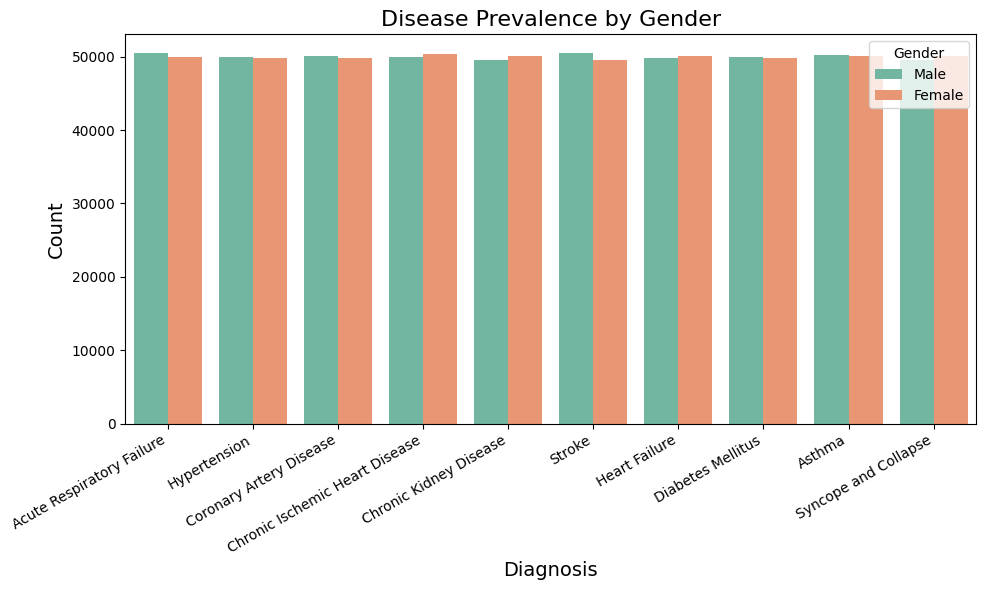

In [75]:
plt.figure(figsize=(10, 6))
sns.countplot(data=df, x='Diagnosis', hue='Gender', palette='Set2')

plt.title('Disease Prevalence by Gender', fontsize=16)
plt.xlabel('Diagnosis', fontsize=14)
plt.ylabel('Count', fontsize=14)
plt.xticks(rotation=30, ha='right')
plt.legend(title='Gender')
plt.tight_layout()
plt.show()


In [ ]:
## Check the 
Diagnosis=df['Diagnosis'].unique()
for i in Diagnosis:
    # print(50*'____')
    print(f'Diagnostic_Patterns for:--> {i} ')
    print(df[df['Diagnosis']==i]['Diagnostic_Patterns'].unique())
    # print(40*'_ _ _')
    sns.histplot(df['Age'])


### 🧾 **7. Anomaly Detection**
- Spot **outliers** in vitals that may indicate potential health risks or data errors.

---
